In [42]:
# importing frameworks/packages that are required for the model to run

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import minmax_scale
#import torch
#from torch import nn, optim
#from torch.autograd import Variable
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler
import imageio
import os
from IPython.display import Image, display

<h1>C-MAPSS dataset Exploratory Data Analysis</h1>
The C-MAPSS dataset, a popular benchmark for evaluating the performance of various machine learning models, was employed to assess the efficacy of our proposed modules. This dataset comprises time-series data collected from 21 sensors, which monitor the degradation patterns of aircraft engines, as illustrated in Figure 6. The sensor data encompasses temperature, pressure, and speed measurements from diverse locations within the engine. The dataset is divided into four subsets: FD001, FD002, FD003, and FD004, with their specific characteristics outlined in our literature review. Notably from our initial exploratory data analysis, FD002 and FD004 are considered more intricate due to their larger number of training and testing trajectories, as well as their involvement in six distinct operational conditions.

### FD001

In [43]:
train_data_FD001 = pd.read_csv("./dataset/train_FD001.txt", sep="\s+", header=None)
train_data_FD001

<>:1: SyntaxWarning: invalid escape sequence '\s'
<>:1: SyntaxWarning: invalid escape sequence '\s'
C:\Users\shawn\AppData\Local\Temp\ipykernel_4212\3696893797.py:1: SyntaxWarning: invalid escape sequence '\s'
  train_data_FD001 = pd.read_csv("./dataset/train_FD001.txt", sep="\s+", header=None)


,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,519.49,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,519.68,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,520.01,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,519.67,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640


In [44]:
np.unique(train_data_FD001[0])

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

In [45]:
num_cycles_to_failure_FD001 = train_data_FD001.groupby(0)[1].count()
num_cycles_to_failure_FD001.values

array([192, 287, 179, 189, 269, 188, 259, 150, 201, 222, 240, 170, 163,
       180, 207, 209, 276, 195, 158, 234, 195, 202, 168, 147, 230, 199,
       156, 165, 163, 194, 234, 191, 200, 195, 181, 158, 170, 194, 128,
       188, 216, 196, 207, 192, 158, 256, 214, 231, 215, 198, 213, 213,
       195, 257, 193, 275, 137, 147, 231, 172, 185, 180, 174, 283, 153,
       202, 313, 199, 362, 137, 208, 213, 213, 166, 229, 210, 154, 231,
       199, 185, 240, 214, 293, 267, 188, 278, 178, 213, 217, 154, 135,
       341, 155, 258, 283, 336, 202, 156, 185, 200], dtype=int64)

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import imageio
import os

# Define paths for each dataset
dataset_paths = {
    "FD001": "./dataset/train_FD001.txt",
    "FD002": "./dataset/train_FD002.txt",
    "FD003": "./dataset/train_FD003.txt",
    "FD004": "./dataset/train_FD004.txt"
}

# Early RUL cap for piecewise model
early_rul = 125

# Dictionary to hold cycle-to-failure data for each dataset
num_cycles_to_failure_datasets = {}

# Define the output directory for GIFs
gif_output_dir = "./gifs"
os.makedirs(gif_output_dir, exist_ok=True)

# Calculate cycle counts to failure for each dataset
for dataset_name, path in dataset_paths.items():
    # Load the dataset
    train_data = pd.read_csv(path, sep="\s+", header=None)
    
    # Calculate cycles to failure for each engine
    num_cycles_to_failure = train_data.groupby(0)[1].count()
    
    # Store the results in the dictionary
    num_cycles_to_failure_datasets[dataset_name] = num_cycles_to_failure
    print(f"Cycle counts to failure calculated for {dataset_name}")

# Now, iterate over each dataset to create the degradation models and generate GIFs
for dataset_name, num_cycles_to_failure in num_cycles_to_failure_datasets.items():
    # Define the output directory for this dataset
    output_dir = f"D:/IT5006GrpProj/CMAPSS_GRP_2/engine_plots_{dataset_name}"
    os.makedirs(output_dir, exist_ok=True)

    images = []

    # Iterate over each engine's cycle count to failure
    for engine_id, cycles in enumerate(num_cycles_to_failure.values, start=1):
        # Linear degradation model
        linear_degradation_model = np.arange(cycles - 1, -1, -1)
        
        # Piecewise linear degradation model
        if cycles > early_rul:
            piecewise_linear_degradation_model = np.append(
                early_rul * np.ones(shape=(cycles - early_rul,)), 
                np.arange(early_rul - 1, -1, -1)
            )
        else:
            piecewise_linear_degradation_model = np.arange(cycles - 1, -1, -1)
        
        # Plotting both models for the current engine
        plt.figure(figsize=(12, 6))
        
        # Linear degradation model plot
        plt.subplot(121)
        plt.plot(linear_degradation_model, label="Linear RUL")
        plt.title(f"Linear Degradation Model (Engine {engine_id})")
        plt.xlabel("Cycle")
        plt.ylabel("RUL")
        plt.grid(True)
        
        # Piecewise linear degradation model plot
        plt.subplot(122)
        plt.plot(piecewise_linear_degradation_model, label="Piecewise Linear RUL")
        plt.title(f"Piecewise Linear Degradation Model (Engine {engine_id})")
        plt.xlabel("Cycle")
        plt.ylabel("RUL")
        plt.grid(True)
        
        # Save the plot as an image
        filename = os.path.join(output_dir, f"engine_{engine_id}.png")
        plt.tight_layout()
        plt.savefig(filename)
        plt.close()
        
        # Append the filename to the images list
        images.append(filename)

    # Create a GIF from the images for this dataset
    gif_filename = os.path.join(gif_output_dir, f"degradation_models_{dataset_name}.gif")
    with imageio.get_writer(gif_filename, mode="I", duration=1) as writer:
        for filename in images:
            image = imageio.imread(filename)
            writer.append_data(image)

    # Remove the image files after creating the GIF to save space
    for filename in images:
        os.remove(filename)

    print(f"GIF created: {gif_filename}")


<>:28: SyntaxWarning: invalid escape sequence '\s'
<>:28: SyntaxWarning: invalid escape sequence '\s'
C:\Users\shawn\AppData\Local\Temp\ipykernel_4212\3252416564.py:28: SyntaxWarning: invalid escape sequence '\s'
  train_data = pd.read_csv(path, sep="\s+", header=None)


Cycle counts to failure calculated for FD001
Cycle counts to failure calculated for FD002
Cycle counts to failure calculated for FD003
Cycle counts to failure calculated for FD004


C:\Users\shawn\AppData\Local\Temp\ipykernel_4212\3252416564.py:91: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


GIF created: ./gifs\degradation_models_FD001.gif
GIF created: ./gifs\degradation_models_FD002.gif
GIF created: ./gifs\degradation_models_FD003.gif
GIF created: ./gifs\degradation_models_FD004.gif


Studies have shown that the initial RUL (Remaining Useful Life) — the early phase of engine degradation — has a minimal impact on predicting RUL accurately. This is because engine degradation is often negligible during the initial cycles, meaning high RUL values (when the engine is far from failure) offer limited insight for maintenance decisions. As a result, the piecewise degradation model is a more effective approach, as it focuses on the most informative part of the engine's life.

The below GIF illustrates this across all four datasets. You can observe that the piecewise linear degradation model consistently caps the RUL at a threshold in the early stages, creating a "plateau" before starting the linear countdown. This approach prioritizes the critical phase closer to failure, where accurate RUL predictions are most valuable.

1. Focuses on the Critical Failure Phase:
- By capping the RUL initially, the piecewise model prioritizes the period when the engine is approaching the end of its life.
- Maintenance decisions are typically most relevant when an engine is closer to failure, as this is when it becomes crucial to predict RUL accurately to avoid unexpected breakdowns.

2. Reduces Noise from Early Life Data:
- In the early stages of an engine's life, degradation can be minimal, and high RUL values do not provide much actionable information.
- The cap on RUL prevents the model from overfocusing on high values that may introduce unnecessary complexity or noise, making it easier to predict the degradation trend as failure approaches.

3. Balances Model Complexity with Practical Insights:
- The piecewise model simplifies the range of values the model needs to learn, improving prediction accuracy by focusing on the last stages of degradation.
- This approach is particularly valuable when training predictive maintenance models, as it provides a balanced view of the engine’s degradation without overwhelming the model with unimportant high RUL values.

FD001


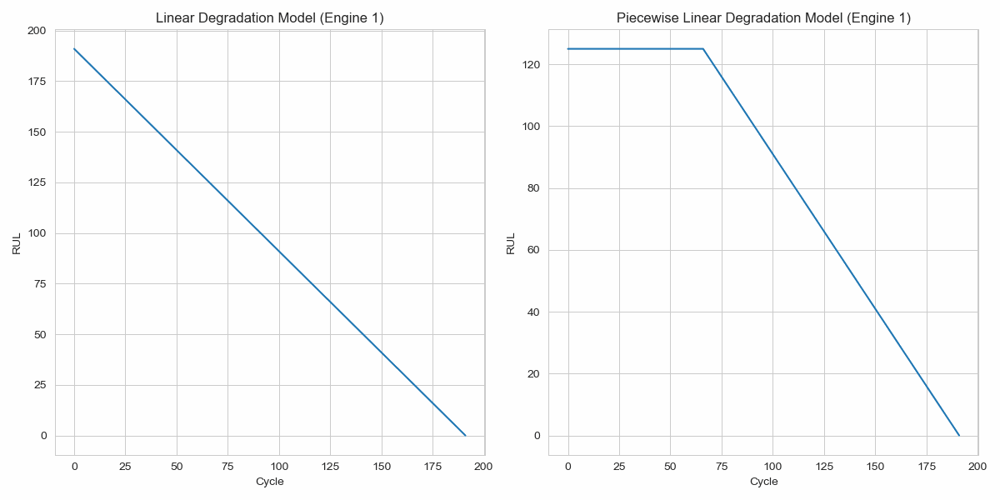

FD002


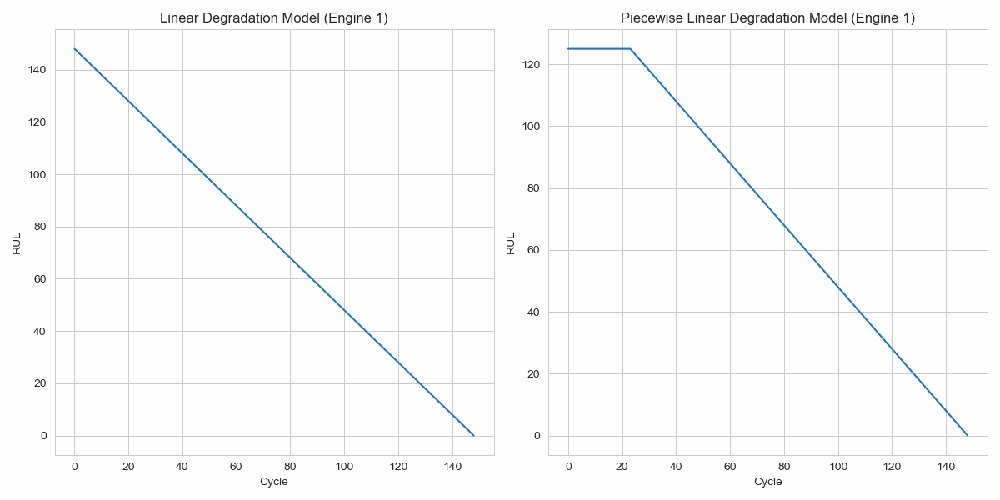

FD003


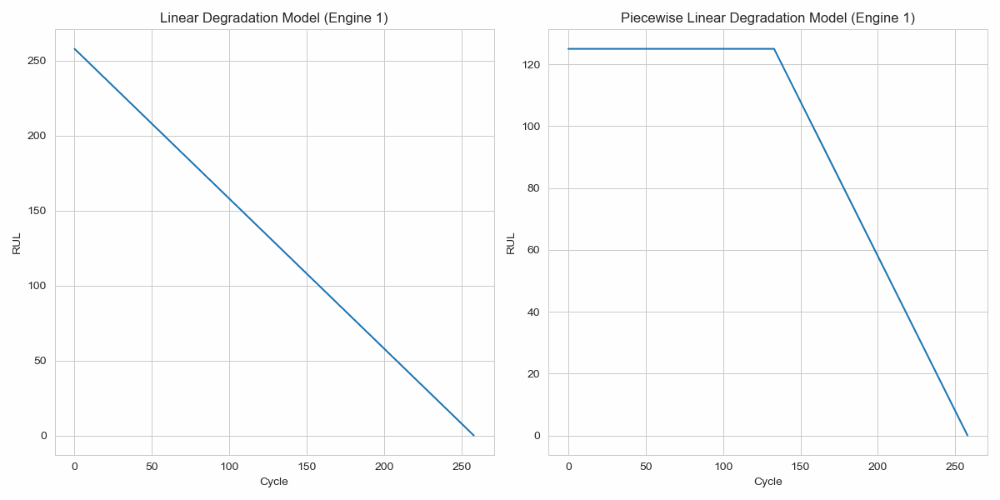

FD004


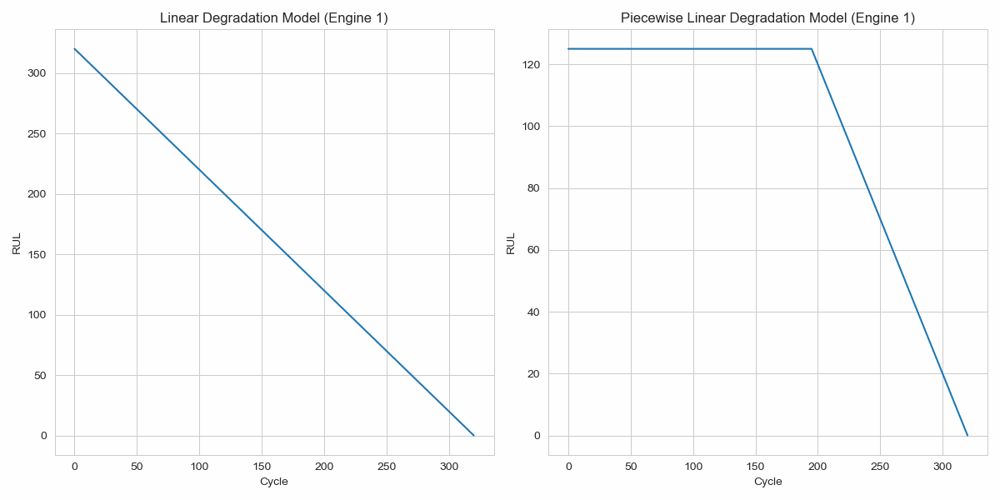

In [34]:
print("FD001")
display(Image(filename="./gifs/degradation_models_FD001.gif"))
print("FD002")
display(Image(filename="./gifs/degradation_models_FD002.gif"))
print("FD003")
display(Image(filename="./gifs/degradation_models_FD003.gif"))
print("FD004")
display(Image(filename="./gifs/degradation_models_FD004.gif"))

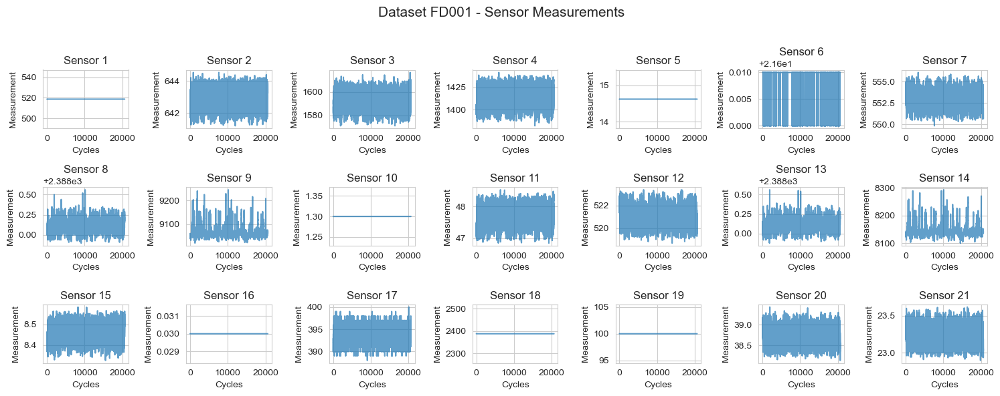

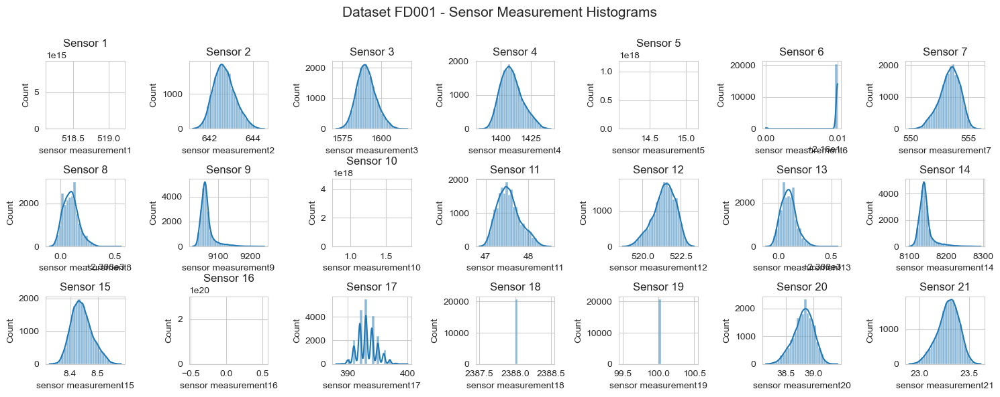

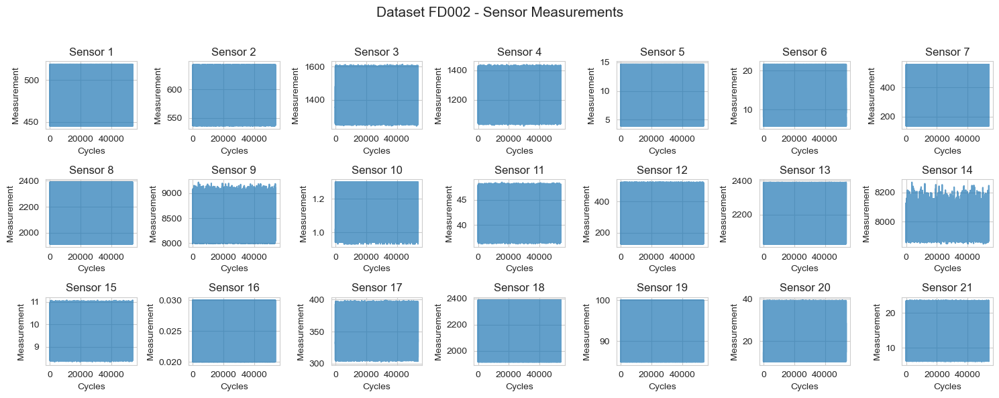

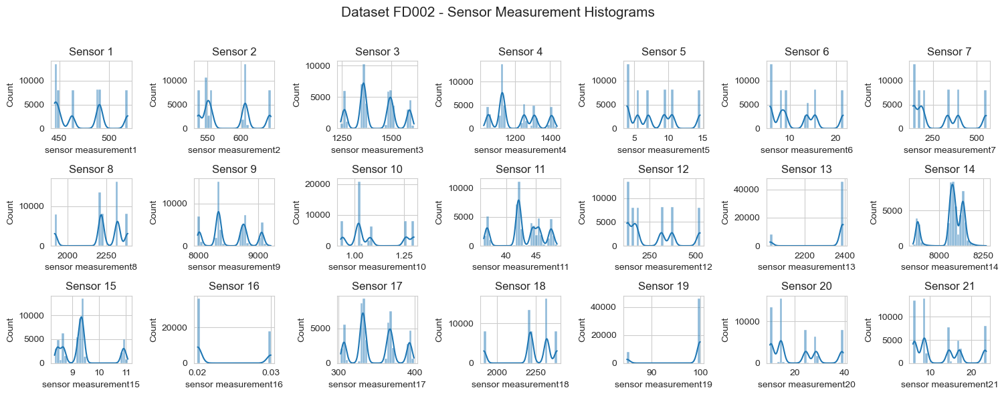

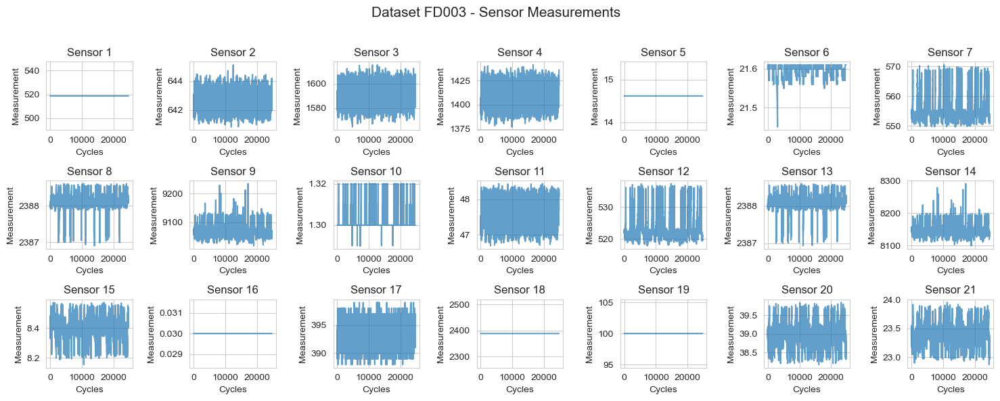

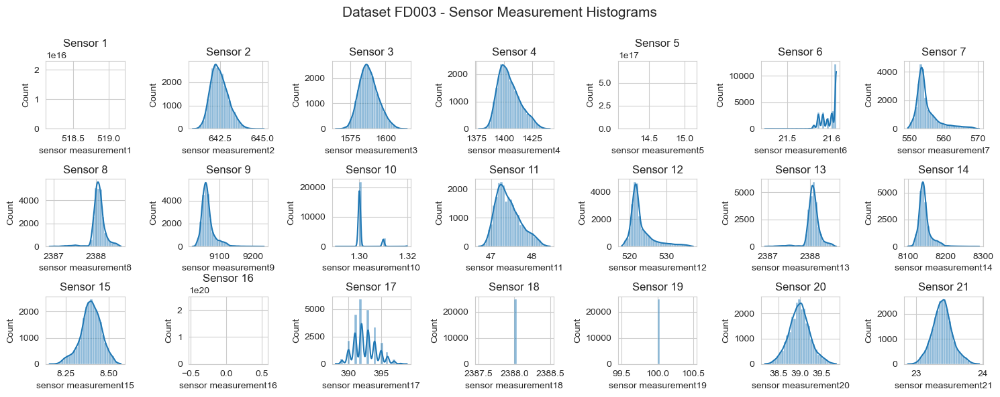

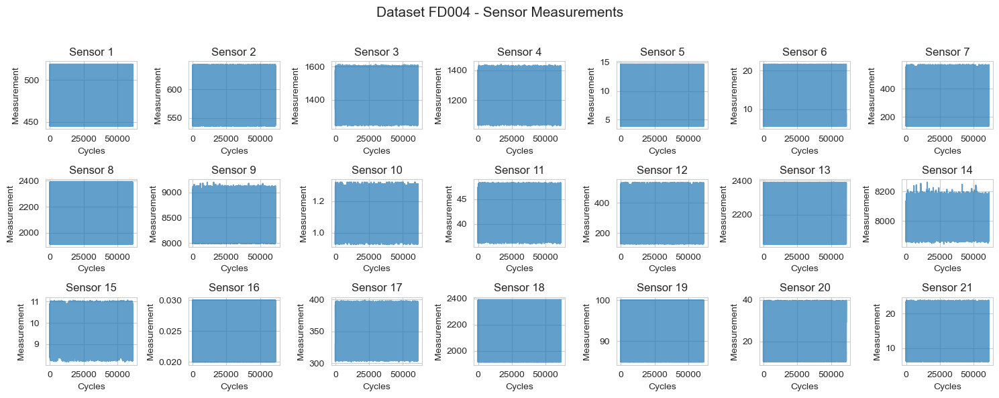

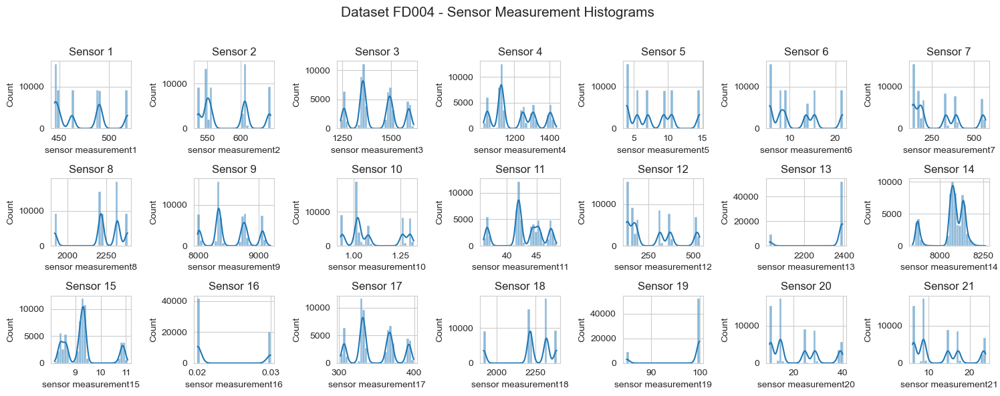

In [46]:
# Set the style for seaborn
sns.set_style("whitegrid")


def data_analysis_plot(j):
    # Load the dataset
    raw1 = np.loadtxt("./dataset/train_FD00" + str(j) + ".txt")
    df1 = pd.DataFrame(
        raw1,
        columns=[
            "unit",
            "cycles",
            "operational setting 1",
            "operational setting 2",
            "operational setting 3",
        ]
        + ["sensor measurement" + str(i) for i in range(1, 22)],
    )

    # Plot sensor measurement time series
    plt.figure(figsize=(15, 6))
    plt.suptitle("Dataset FD00" + str(j) + " - Sensor Measurements", fontsize=15)
    for i in range(1, 22):
        plt.subplot(3, 7, i)
        plt.title("Sensor " + str(i), fontsize=12)
        plt.plot(df1.iloc[:, i + 4], alpha=0.7)
        plt.xlabel("Cycles")
        plt.ylabel("Measurement")
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # Plot histograms of sensor measurements
    plt.figure(figsize=(15, 6))
    plt.suptitle("Dataset FD00" + str(j) + " - Sensor Measurement Histograms", fontsize=15)
    for i in range(1, 22):
        plt.subplot(3, 7, i)
        plt.title("Sensor " + str(i), fontsize=12)
        sns.histplot(df1.iloc[:, i + 4], kde=True, bins=30)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


if __name__ == "__main__":
    # Iterate through datasets
    for dataset_number in range(1, 5):
        data_analysis_plot(dataset_number)

<h1>Exploratory Data Analysis on FD001</h1>

Data Preparation:

While the C-MAPSS dataset contains 21 sensors, certain sensors provide constant values, limiting their usefulness for our task. In line with previous research [8, 9], we eliminated these redundant sensors, focusing on the remaining 14. To process the time-series data, we employed a sliding window technique [5, 9, 37] with a window size of 30. For sequences shorter than 30, we padded them with the initial value. Data normalization is a crucial step in RUL prediction, and we adopted min-max normalization as suggested in [8]. To enhance the accuracy of RUL predictions, we incorporated piece-wise linear scaling for RUL values [38], capping the maximum RUL at 125.

In [36]:
# Set column names based on the C-MAPSS dataset structure
columns = ["unit_ID", "time_in_cycles"] + [f"op_setting_{i}" for i in range(3)] + [f"sensor_{i}" for i in range(1, 22)]
train_data_FD001.columns = columns

# Calculate mean and variance for each sensor across all units
sensor_stats = train_data_FD001.groupby('unit_ID').agg({f"sensor_{i}": ['mean', 'var'] for i in range(1, 22)})
sensor_stats.columns = [f"{stat}_{sensor}" for sensor, stat in sensor_stats.columns]  

# Display the results
sensor_stats

,mean_sensor_1,var_sensor_1,mean_sensor_2,var_sensor_2,mean_sensor_3,var_sensor_3,mean_sensor_4,var_sensor_4,mean_sensor_5,var_sensor_5,...,mean_sensor_17,var_sensor_17,mean_sensor_18,var_sensor_18,mean_sensor_19,var_sensor_19,mean_sensor_20,var_sensor_20,mean_sensor_21,var_sensor_21
unit_ID,,,,,,,,,,,,,,,,,,,,,
1,518.67,0.0,642.621042,0.236970,1589.485521,33.175014,1407.262135,73.369669,14.62,0.0,...,392.854167,2.177574,2388.0,0.0,100.0,0.0,38.840052,0.027888,23.306310,0.011046
2,518.67,0.0,642.435226,0.313840,1588.181986,43.516841,1404.265854,94.813992,14.62,0.0,...,392.386760,2.713530,2388.0,0.0,100.0,0.0,38.901150,0.039733,23.338997,0.013178
3,518.67,0.0,642.543743,0.224856,1588.715084,40.783834,1405.628994,74.134274,14.62,0.0,...,392.754190,2.467328,2388.0,0.0,100.0,0.0,38.882793,0.027593,23.321931,0.010969
4,518.67,0.0,642.662381,0.194875,1590.563280,37.321735,1408.253915,59.868334,14.62,0.0,...,393.291005,2.569121,2388.0,0.0,100.0,0.0,38.830265,0.025377,23.294502,0.008799
5,518.67,0.0,642.451970,0.304199,1588.153271,49.852747,1404.878439,95.694186,14.62,0.0,...,392.646840,3.027798,2388.0,0.0,100.0,0.0,38.891078,0.035019,23.336284,0.012702
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,518.67,0.0,642.629821,0.251022,1589.856190,34.260669,1407.889970,77.282009,14.62,0.0,...,393.110119,2.289330,2388.0,0.0,100.0,0.0,38.826339,0.032565,23.300243,0.011320
97,518.67,0.0,642.522624,0.224603,1589.431436,38.006313,1405.888267,58.811995,14.62,0.0,...,392.801980,2.438205,2388.0,0.0,100.0,0.0,38.881337,0.029228,23.326633,0.008705
98,518.67,0.0,642.584872,0.276576,1588.884167,39.844641,1406.270962,95.092965,14.62,0.0,...,392.724359,1.981596,2388.0,0.0,100.0,0.0,38.860128,0.031388,23.331571,0.011545


Variance threshold has been defined as 0.1 to consider sensors with low variance as those with an average variance below this threshold across all units will be considered low variance.

In [37]:
# Define a threshold to identify low-variance sensors
variance_threshold = 0.1  

# Identify sensors with variance below the threshold across all units
low_variance_sensors = [col for col in sensor_stats.columns if 'var' in col and sensor_stats[col].mean() < variance_threshold]

# Extract and display only the sensors with low variance across units
low_variance_sensors_data = sensor_stats[low_variance_sensors]

mean_variance_values = low_variance_sensors_data.mean()
print("Mean variance for low-variance sensors:")
print(mean_variance_values)


Mean variance for low-variance sensors:
var_sensor_1     0.000000
var_sensor_5     0.000000
var_sensor_6     0.000002
var_sensor_8     0.003442
var_sensor_10    0.000000
var_sensor_11    0.057612
var_sensor_13    0.003526
var_sensor_15    0.001201
var_sensor_16    0.000000
var_sensor_18    0.000000
var_sensor_19    0.000000
var_sensor_20    0.027993
var_sensor_21    0.010023
dtype: float64


Hence, judging from the above results we have decide to drop sensors 1, 5, 6, 10, 16, 18, 19 as they have a variance close to or equal to zero across units, indicating very little fluctuation over time. This suggests they don’t capture meaningful changes or degradation patterns.

 ### Correlation Matrix

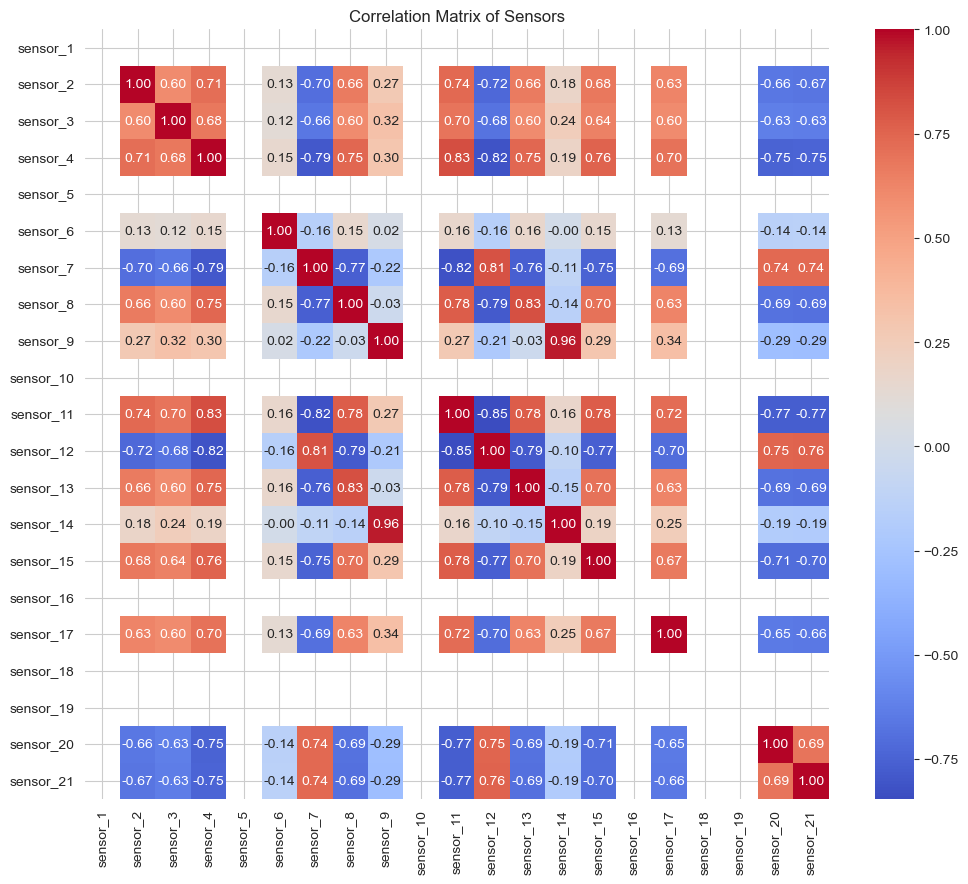

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt

# Drop non-sensor columns (like 'unit_ID' and 'time_in_cycles') to focus only on sensor readings
sensor_data = train_data_FD001.drop(columns=["unit_ID", "time_in_cycles", "op_setting_0", "op_setting_1", "op_setting_2"])

# Calculate the correlation matrix
correlation_matrix = sensor_data.corr()

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix of Sensors")
plt.show()


In addition from the correlation matrix above we can clearly see that sensor 9 and 14 having high correlation of 0.96 which suggests  redundancy. Highly correlated features often contain overlapping information. Including both in the model may add redundancy without improving predictive power.

In [39]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score

# Calculate RUL based on the maximum cycle for each unit
train_data_FD001['RUL'] = train_data_FD001.groupby('unit_ID')['time_in_cycles'].transform('max') - train_data_FD001['time_in_cycles']

# Identify highly correlated pairs and drop one sensor from each pair for Dataset B
dropped_sensors = ["sensor_9"]  # Example: dropping one of each highly correlated pair
train_data_dropped = train_data_FD001.drop(columns=dropped_sensors, errors='ignore')

# Separate features and target variable for both datasets
X_full = train_data_FD001.drop(columns=["RUL"])  # Dataset A: All sensors
X_dropped = train_data_dropped.drop(columns=["RUL"])  # Dataset B: Dropped correlated sensors
y = train_data_FD001["RUL"]

# Initialize the model
model = RandomForestRegressor(n_estimators=100, random_state=42)

# Perform cross-validation on both datasets
cv_scores_full = cross_val_score(model, X_full, y, cv=5, scoring='neg_mean_squared_error')
cv_scores_dropped = cross_val_score(model, X_dropped, y, cv=5, scoring='neg_mean_squared_error')

# Calculate mean and standard deviation of cross-validation scores
mean_score_full = np.mean(cv_scores_full)
std_score_full = np.std(cv_scores_full)

mean_score_dropped = np.mean(cv_scores_dropped)
std_score_dropped = np.std(cv_scores_dropped)

# Display results
print("Cross-Validation Results:")
print(f"With All Sensors: Mean MSE = {-mean_score_full:.4f}, Std = {std_score_full:.4f}")
print(f"With Dropped Correlated Sensors: Mean MSE = {-mean_score_dropped:.4f}, Std = {std_score_dropped:.4f}")


Cross-Validation Results:
With All Sensors: Mean MSE = 2099.8668, Std = 922.9522
With Dropped Correlated Sensors: Mean MSE = 2122.9431, Std = 942.6620


There is a slight increase in MSE when correlated sensors were dropped, from 2099.87 to 2122.94. This indicates a minor decrease in predictive performance when the correlated sensors are removed. However, this difference is quite small, suggesting that the correlated sensors didn’t contribute significantly to predictive accuracy. The standard deviation of the MSE increased slightly as well (from 922.95 to 942.66), suggesting that the model’s predictions became marginally less consistent after dropping the correlated sensors. Hence, sensor 9 is not dropped.

<h2>Understanding the Piecewise Labeling</h2>

**Objective of Labeling:**

The goal is to create an RUL label for each cycle within a time window that reflects the number of cycles left before the unit fails. The RUL label decreases over time as the unit progresses through its lifecycle.

**Piecewise Label with a Cap:**

Instead of allowing RUL to decrease all the way to zero, the code applies a piecewise cap on the RUL values at 125 cycles. This means that any calculated RUL greater than 125 is set to 125.

**Why Cap the RUL?**

In practice, equipment degradation might not be linear. Beyond a certain point, the RUL values become less informative as they exceed a certain threshold.
Setting a cap at 125 helps standardize labels for cycles that are far from failure, which can make models easier to train and generalize. It reduces noise from high RUL values that may not have a strong predictive signal.

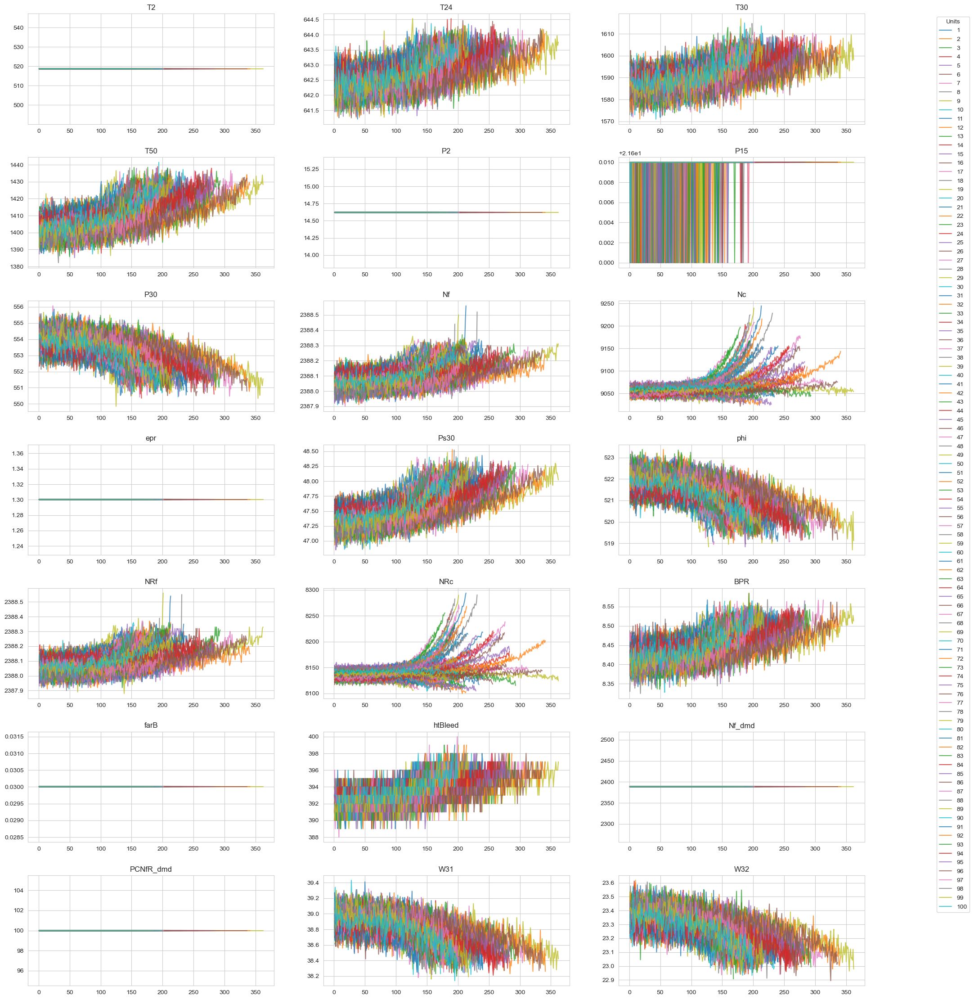

Remaining columns in train_df: Index(['unit_ID', 'cycles', 'setting_1', 'setting_2', 'setting_3', 'T24',
       'T30', 'T50', 'P30', 'Nf', 'Nc', 'Ps30', 'phi', 'NRf', 'NRc', 'BPR',
       'htBleed', 'W31', 'W32'],
      dtype='object')
Remaining columns in test_df: Index(['unit_ID', 'cycles', 'setting_1', 'setting_2', 'setting_3', 'T24',
       'T30', 'T50', 'P30', 'Nf', 'Nc', 'Ps30', 'phi', 'NRf', 'NRc', 'BPR',
       'htBleed', 'W31', 'W32'],
      dtype='object')
Processed train data shape:  (14184, 30, 17)
Processed validation data shape:  (3547, 30, 17)
Processed train targets shape:  (14184,)
Processed validation targets shape:  (3547,)


In [47]:
# Set the style for seaborn
sns.set_style("whitegrid")


# Function to load and clean data
def load_and_clean_data(train_path, test_path, rul_path, columns, truth_columns):
    train_df = pd.read_csv(train_path, sep=" ", header=None).dropna(axis=1)
    test_df = pd.read_csv(test_path, sep=" ", header=None).dropna(axis=1)
    rul_df = pd.read_csv(rul_path, sep=" ", header=None).dropna(axis=1)
    rul_df.insert(0, "unit_ID", range(1, len(rul_df) + 1))

    train_df.columns = columns
    test_df.columns = columns
    rul_df.columns = truth_columns

    return train_df, test_df, rul_df


# Plotting function for sensor measurements
def plot_sensor_measurements(df, columns):
    fig, ax = plt.subplots(ncols=3, nrows=7, figsize=(24, 24))
    ax = ax.ravel()

    for i, sensor in enumerate(columns[5:]):  # Loop through sensor columns
        for j, unit in enumerate(df["unit_ID"].unique()):
            unit_data = df[df["unit_ID"] == unit]
            if j == 0:  # Add label only for the first unit to avoid duplication
                ax[i].plot(
                    unit_data["cycles"],
                    unit_data[sensor],
                    label=f"Unit {unit}",
                    alpha=0.75,
                )
            else:
                ax[i].plot(unit_data["cycles"], unit_data[sensor], alpha=0.75)

        ax[i].title.set_text(sensor)
        ax[i].legend().set_visible(False)

    plt.subplots_adjust(top=0.95, bottom=0.05, hspace=0.3, wspace=0.2)
    # Add a global legend outside the loop for the entire figure if needed
    fig.legend(
        df["unit_ID"].unique(),
        loc="upper right",
        title="Units",
        bbox_to_anchor=(1, 0.95),
    )
    plt.show()


# Function for generating RUL targets - Piecewise Labelling
def process_targets(data_length, early_rul=None):
    if early_rul is None:
        return np.arange(data_length - 1, -1, -1)
    else:
        early_rul_duration = data_length - early_rul
        if early_rul_duration <= 0:
            return np.arange(data_length - 1, -1, -1)
        else:
            return np.append(early_rul * np.ones(early_rul_duration), np.arange(early_rul - 1, -1, -1))


# Function for processing data with sliding windows
def process_input_data_with_targets(input_data, target_data=None, window_length=1, shift=1):
    num_batches = int(np.floor((len(input_data) - window_length) / shift)) + 1
    output_data = np.zeros((num_batches, window_length, input_data.shape[1]))

    if target_data is None:
        for batch in range(num_batches):
            output_data[batch, :, :] = input_data[shift * batch : shift * batch + window_length, :]
        return output_data
    else:
        output_targets = np.zeros(num_batches)
        for batch in range(num_batches):
            output_data[batch, :, :] = input_data[shift * batch : shift * batch + window_length, :]
            output_targets[batch] = target_data[shift * batch + window_length - 1]
        return output_data, output_targets


if __name__ == "__main__":
    # Define file paths
    train_path = "./dataset/train_FD001.txt"
    test_path = "./dataset/test_FD001.txt"
    rul_path = "./dataset/RUL_FD001.txt"

    # Define column names
    columns = [
        "unit_ID", 
        "cycles", 
        "setting_1", 
        "setting_2", 
        "setting_3",
        "T2", # Sensor 1
        "T24", # Sensor 2
        "T30", # Sensor 3
        "T50", # Sensor 4
        "P2", # Sensor 5
        "P15", # Sensor 6
        "P30", # Sensor 7
        "Nf", # Sensor 8
        "Nc", # Sensor 9
        "epr", # Sensor 10
        "Ps30", # Sensor 11
        "phi", # Sensor 12
        "NRf", # Sensor 13
        "NRc", # Sensor 14
        "BPR", # Sensor 15
        "farB", # Sensor 16
        "htBleed", # Sensor 17
        "Nf_dmd", # Sensor 18
        "PCNfR_dmd", # Sensor 19
        "W31", # Sensor 20
        "W32", # Sensor 21
    ]
    truth_columns = ["unit_ID", "RUL"]

    # Load and clean data
    train_df, test_df, rul_df = load_and_clean_data(train_path, test_path, rul_path, columns, truth_columns)

    # Visualize data
    plot_sensor_measurements(train_df, columns)

    # Feature Selection: Remove redundant columns
    columns_to_remove = ["T2", "P2", "P15", "epr", "farB", "Nf_dmd", "PCNfR_dmd"] # dropped sensor 1, 5, 6, 10, 16, 18, 19
    train_df.drop(columns=columns_to_remove, inplace=True)
    test_df.drop(columns=columns_to_remove, inplace=True)

    # Check remaining columns after dropping
    print("Remaining columns in train_df:", train_df.columns)
    print("Remaining columns in test_df:", test_df.columns)

    # Save the unit_ID column before scaling
    train_data_first_column = train_df["unit_ID"].copy()
    test_data_first_column = test_df["unit_ID"].copy()

    # Min-max scaling
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train_df.drop(columns=["unit_ID"]))
    test_scaled = scaler.transform(test_df.drop(columns=["unit_ID"]))
    train_df = pd.DataFrame(train_scaled, columns=train_df.columns[1:])
    test_df = pd.DataFrame(test_scaled, columns=test_df.columns[1:])
    train_df.insert(0, "unit_ID", train_data_first_column.values)
    test_df.insert(0, "unit_ID", test_data_first_column.values)

    # Parameters for sliding windows,shifts,early RUL and empty lists to store generated sample data from using shifting window
    window_length = 30
    shift = 1
    early_rul = 125           
    processed_train_data = []
    processed_train_targets = []
    num_test_windows = 5     
    processed_test_data = []
    num_test_windows_list = []

    train_data_first_column = train_df["unit_ID"]
    test_data_first_column = test_df["unit_ID"]

    # Sliding window processing
    processed_train_data, processed_train_targets = [], []
    for unit_id in train_df["unit_ID"].unique():
        unit_data = train_df[train_df["unit_ID"] == unit_id].drop(columns=["unit_ID", "cycles"]).values
        if len(unit_data) < window_length:
            print(f"Unit {unit_id} has insufficient data for window length {window_length}")
            raise ValueError("Window length exceeds data length for some units")

        unit_targets = process_targets(len(unit_data), early_rul=early_rul)
        data, targets = process_input_data_with_targets(unit_data, unit_targets, window_length, shift)
        processed_train_data.append(data)
        processed_train_targets.append(targets)

    processed_train_data = np.concatenate(processed_train_data)
    processed_train_targets = np.concatenate(processed_train_targets)

    # Train-validation split
    processed_train_data, processed_val_data, processed_train_targets, processed_val_targets = train_test_split(processed_train_data,
                                                                                                            processed_train_targets,
                                                                                                            test_size = 0.2,
                                                                                                            random_state = 83)
    print("Processed train data shape: ", processed_train_data.shape)
    print("Processed validation data shape: ", processed_val_data.shape)
    print("Processed train targets shape: ", processed_train_targets.shape)
    print("Processed validation targets shape: ", processed_val_targets.shape)


### Sliding Window Comparison

In [58]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split

# Function to generate labels and features without sliding window (only final cycle data)
def prepare_data_without_sliding_window(df, label_cap=125.0):
    data = []
    labels = []
    for unit in df["unit_ID"].unique():
        unit_data = df[df["unit_ID"] == unit]
        max_cycles = unit_data["cycles"].max()
        
        # Use only the final cycle data as input
        final_data = unit_data[unit_data["cycles"] == max_cycles].iloc[:, 2:-1].values.flatten()
        data.append(final_data)
        
        # Label: Remaining Useful Life capped at label_cap
        label = min(max_cycles, label_cap)
        labels.append(label)
    
    return np.array(data), np.array(labels)

# Function to generate labels and features with sliding window
def prepare_data_with_sliding_window(df, window_size=30, label_cap=125.0):
    data = []
    labels = []
    
    for unit in df["unit_ID"].unique():
        unit_data = df[df["unit_ID"] == unit]
        max_cycles = unit_data["cycles"].max()
        
        for i in range(len(unit_data)):
            # Cap RUL and add label
            label = min(max_cycles - unit_data.iloc[i]["cycles"], label_cap)
            
            # Extract sliding window
            start = max(0, i - window_size + 1)
            window = unit_data.iloc[start:i+1, 2:-1].values  # Exclude 'unit_ID' and 'cycles'
            if window.shape[0] < window_size:
                window = np.pad(window, ((window_size - window.shape[0], 0), (0, 0)), 'edge')
            
            data.append(window.flatten())
            labels.append(label)
    
    return np.array(data), np.array(labels)

# Prepare data without sliding window
data_no_window, labels_no_window = prepare_data_without_sliding_window(train_df)

# Prepare data with sliding window
data_with_window, labels_with_window = prepare_data_with_sliding_window(train_df)

# Split both datasets into training and testing sets
X_train_no, X_test_no, y_train_no, y_test_no = train_test_split(data_no_window, labels_no_window, test_size=0.2, random_state=42)
X_train_with, X_test_with, y_train_with, y_test_with = train_test_split(data_with_window, labels_with_window, test_size=0.2, random_state=42)

# Train linear regression model without sliding window
model_no_window = LinearRegression()
model_no_window.fit(X_train_no, y_train_no)
y_pred_no_window = model_no_window.predict(X_test_no)

# Train linear regression model with sliding window
model_with_window = LinearRegression()
model_with_window.fit(X_train_with, y_train_with)
y_pred_with_window = model_with_window.predict(X_test_with)

# Evaluate and compare models
mae_no_window = mean_absolute_error(y_test_no, y_pred_no_window)
mae_with_window = mean_absolute_error(y_test_with, y_pred_with_window)

print("Mean Absolute Error without Sliding Window:", mae_no_window)
print("Mean Absolute Error with Sliding Window:", mae_with_window)



Mean Absolute Error without Sliding Window: 0.11734040918867691
Mean Absolute Error with Sliding Window: 0.08606316411770926
